In [1]:
import pandas as pd
import numpy as np
import sklearn 
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
df = pd.read_csv('goodreads_books.csv')

In [3]:
df.head()

,id,title,link,series,cover_link,author,author_link,rating_count,review_count,average_rating,...,isbn13,asin,settings,characters,awards,amazon_redirect_link,worldcat_redirect_link,recommended_books,books_in_series,description
0,630104,Inner Circle,https://www.goodreads.com//book/show/630104.In...,(Private #5),https://i.gr-assets.com/images/S/compressed.ph...,"Kate Brian, Julian Peploe",https://www.goodreads.com/author/show/94091.Ka...,7597,196,4.03,...,9781416950417,NaN,NaN,NaN,NaN,https://www.goodreads.com//book_link/follow/17...,https://www.goodreads.com//book_link/follow/8?...,"726458, 726458, 1537534, 3047848, 1651302, 304...","381489, 381501, 352428, 630103, 1783281, 17832...",Reed Brennan arrived at Easton Academy expecti...
1,9487,A Time to Embrace,https://www.goodreads.com//book/show/9487.A_Ti...,(Timeless Love #2),https://i.gr-assets.com/images/S/compressed.ph...,Karen Kingsbury,https://www.goodreads.com/author/show/3159984....,4179,177,4.35,...,9781595542328,NaN,NaN,NaN,NaN,https://www.goodreads.com//book_link/follow/17...,https://www.goodreads.com//book_link/follow/8?...,"127352, 127352, 40642197, 127353, 127354, 3891...",115036,"Ideje az Ã¶lelÃ©snek TÃ¶rtÃ©net a remÃ©nyrÅl,..."
2,6050894,Take Two,https://www.goodreads.com//book/show/6050894-t...,(Above the Line #2),https://i.gr-assets.com/images/S/compressed.ph...,Karen Kingsbury,https://www.goodreads.com/author/show/3159984....,6288,218,4.23,...,NaN,NaN,"Bloomington, Indiana(United States)",NaN,NaN,https://www.goodreads.com//book_link/follow/17...,https://www.goodreads.com//book_link/follow/8?...,"706250, 706250, 666481, 11942636, 706241, 1273...","4010795, 40792877, 7306261",Filmmakers Chase Ryan and Keith Ellison have c...
3,39030,Reliquary,https://www.goodreads.com//book/show/39030.Rel...,(Pendergast #2),https://i.gr-assets.com/images/S/compressed.ph...,"Douglas Preston, Lincoln Child",https://www.goodreads.com/author/show/12577.Do...,38382,1424,4.01,...,9780765354952,NaN,"New York State(United States) New York City, N...","Aloysius X.L. Pendergast, Margo Green, William...",NaN,https://www.goodreads.com//book_link/follow/17...,https://www.goodreads.com//book_link/follow/8?...,"39026, 39026, 11007668, 3986318, 51887330, 194...","67035, 39031, 39033, 136637, 136638, 30068, 39...",NaN
4,998,The Millionaire Next Door: The Surprising Secr...,https://www.goodreads.com//book/show/998.The_M...,NaN,https://i.gr-assets.com/images/S/compressed.ph...,"Thomas J. Stanley, William D. Danko",https://www.goodreads.com/author/show/659.Thom...,72168,3217,4.04,...,9780671015206,NaN,NaN,NaN,Independent Publisher Book Award (IPPY) Nomine...,https://www.goodreads.com//book_link/follow/17...,https://www.goodreads.com//book_link/follow/8?...,"1052, 1052, 763362, 69571, 78427, 30186948, 10...",NaN,The incredible national bestseller that is cha...


In [4]:
df.dtypes

id                          int64
title                      object
link                       object
series                     object
cover_link                 object
author                     object
author_link                object
rating_count                int64
review_count                int64
average_rating            float64
five_star_ratings           int64
four_star_ratings           int64
three_star_ratings          int64
two_star_ratings            int64
one_star_ratings            int64
number_of_pages           float64
date_published             object
publisher                  object
original_title             object
genre_and_votes            object
isbn                       object
isbn13                     object
asin                       object
settings                   object
characters                 object
awards                     object
amazon_redirect_link       object
worldcat_redirect_link     object
recommended_books          object
books_in_serie

In [5]:
df = df.drop(columns=['link', 'series', 'cover_link', 'author_link', 'original_title', 'isbn', 'isbn13', 'asin', 'settings', 'characters', 
                'amazon_redirect_link', 'worldcat_redirect_link', 'recommended_books', 'description'])
# Get rid of the columns that won't be of use for this project

In [6]:
df.shape

(52199, 17)

In [7]:
df.dtypes
# Looks good to me :) 
# if they are indexed, do I really need the id?

id                      int64
title                  object
author                 object
rating_count            int64
review_count            int64
average_rating        float64
five_star_ratings       int64
four_star_ratings       int64
three_star_ratings      int64
two_star_ratings        int64
one_star_ratings        int64
number_of_pages       float64
date_published         object
publisher              object
genre_and_votes        object
awards                 object
books_in_series        object
dtype: object

In [8]:
df['number_of_pages'].sort_values()

21789    0.0
37718    0.0
37632    0.0
33033    0.0
24641    0.0
        ... 
51815    NaN
51881    NaN
51921    NaN
51925    NaN
52180    NaN
Name: number_of_pages, Length: 52199, dtype: float64

In [9]:
print(df[df['number_of_pages'] < 1].count()) # 167 books with 0 pages
print(df[df['number_of_pages'].isnull()].count()) # 2330 books with NaN pages
# Lots of 0s and NaNs
# Let's go ahead and remove those pesky 0s and NaNs

id                    167
title                 167
author                167
rating_count          167
review_count          167
average_rating        167
five_star_ratings     167
four_star_ratings     167
three_star_ratings    167
two_star_ratings      167
one_star_ratings      167
number_of_pages       167
date_published        166
publisher             166
genre_and_votes       151
awards                  6
books_in_series        49
dtype: int64
id                    2330
title                 2330
author                2330
rating_count          2330
review_count          2330
average_rating        2330
five_star_ratings     2330
four_star_ratings     2330
three_star_ratings    2330
two_star_ratings      2330
one_star_ratings      2330
number_of_pages          0
date_published        1667
publisher             1314
genre_and_votes       1874
awards                  95
books_in_series        780
dtype: int64


In [10]:
df = df[df['number_of_pages'] > 0]
df = df[~df['number_of_pages'].isnull()]


In [11]:
df.dropna
df['number_of_pages'].sort_values()
# successfully dropped the 0s and NaNs.  Those 1s are still strange, but I'll leave them be for now

11345        1.0
8161         1.0
28779        1.0
22256        1.0
45276        1.0
          ...   
9150      8124.0
46657     8245.0
49801     8258.0
12024    11095.0
771      14777.0
Name: number_of_pages, Length: 49702, dtype: float64

<AxesSubplot:>

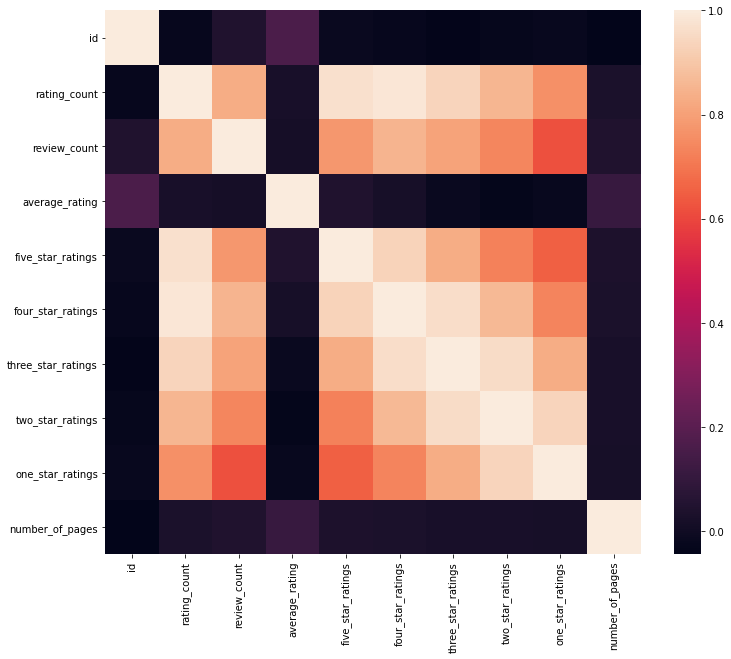

In [12]:
corr_matrix = df.corr()
fig, ax = plt.subplots(figsize=(12,10))
sns.heatmap(corr_matrix)
# I guess it makes sense that none of these numerical columns correlate with average rating in any useful way
# Maybe the boost in rating for larger books will be an interesting lead, though the correlation is weak

In [13]:
fig = px.histogram(df, x="average_rating")
fig.show()
# This shows a strange spike at 5 star rating.  Let's investigate
# There are several spikes around 3, 3.5, 4, 4.5 etc.  My running assumption is that this is the count of the many books that don't have enough reviews to get them into the grey area between ratings.

In [14]:
print(df[df['average_rating'] == 5.00]['rating_count'].mean())
print(df[df['average_rating'] == 5.00]['rating_count'].std())
# It looks like most of the 5 star average books typically don't have many ratings.
# It may be a good idea to exclude all books with fewer than 50 ratings.

3.787833827893175
14.79079772129872


In [15]:
df[df['average_rating'] == 5.00]['rating_count'].sort_values(ascending=False)
# What's that one amazing book?

44353    375
7905      37
41683     35
11932     32
9981      28
        ... 
18561      1
18261      1
18082      1
17997      1
13486      1
Name: rating_count, Length: 674, dtype: int64

In [16]:
df[df.index==44353]
# What a strange little book

,id,title,author,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages,date_published,publisher,genre_and_votes,awards,books_in_series
44353,45021686,The Devil's Deceptions: Is There Life After De...,Ginger Baum,375,15,5.0,374,1,0,0,0,50.0,April 9th 2019,NaN,NaN,NaN,NaN


In [17]:
fig = px.histogram(df, x="average_rating", nbins=50)
fig.show()
# a clearer look that blurs the outliars.  I will now handle the 'outliars'.
# From here on out, I will try excluding any book that has fewer than 50 reviews as not being reliable

In [18]:
df_popular = df[df['review_count'] > 50]
# create a second dataframe that only contains books with more than 50 reviews

In [19]:
df_popular['review_count'].min()
# just double checking

51

In [20]:
px.histogram(df_popular, x = 'average_rating')
# looks much more regular
# it seems to be a normally distributed 

In [21]:
df_popular['average_rating'].describe()

count    35313.000000
mean         3.990710
std          0.272398
min          1.660000
25%          3.820000
50%          4.000000
75%          4.180000
max          4.930000
Name: average_rating, dtype: float64

In [22]:
rating_compare = {"df": df['average_rating'],
        "df_popular": df_popular['average_rating']}
rating_compare = pd.concat(rating_compare,
               axis = 1)
rating_compare.describe()
# As predicted, the stdev drops when unpopular books are excluded.
# with the exception of the min and max, the distribution doesn't seem to be very different

,df,df_popular
count,49702.000000,35313.000000
mean,4.015400,3.990710
std,0.350714,0.272398
min,0.000000,1.660000
25%,3.820000,3.820000
50%,4.020000,4.000000
75%,4.220000,4.180000
max,5.000000,4.930000


# Book Length
### How does book length effect average rating and the number of ratings?

In [23]:
import plotly.express as px






# df = px.data.tips()
# fig = px.scatter(
#     df, x='total_bill', y='tip', opacity=0.65,
#     trendline='ols', trendline_color_override='darkblue'
# )
# fig.show()

In [67]:
px.scatter(data_frame=df_popular, x='number_of_pages', y='average_rating', hover_name="title", trendline='lowess')
# those outliars....
# ps A+ on Wheel of Time and The Story of Civilization.  Though those are both totally series, not books
# there seems to be a trend here.  I don't think it's worth regressing, but what the hell, why not

In [64]:
df_popular_reduced = df_popular.loc[df['number_of_pages'] < 2000]


In [97]:
px.scatter(data_frame=df_popular_reduced, x='number_of_pages', y='average_rating', hover_name="title")


In [71]:
px.scatter(data_frame=df_popular_reduced, x='number_of_pages', y='review_count', hover_name="title")
# makes sense that there's a 'sweet spot' around 300-400 pages.  
# let's try a list that has more than 40,000 reviews

# Should it be a series?

In [93]:
not_series = df_popular_reduced[df_popular_reduced['books_in_series'].isnull()]
not_series.describe()

,id,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages
count,1.768100e+04,1.768100e+04,17681.000000,17681.000000,1.768100e+04,1.768100e+04,17681.000000,17681.000000,17681.000000,17681.000000
mean,7.691272e+06,2.709103e+04,1550.267915,3.935265,1.049445e+04,9.189170e+03,5278.143940,1483.661784,645.603020,324.445450
std,1.101380e+07,1.302155e+05,5122.345767,0.283100,5.800998e+04,4.170691e+04,23078.237163,7172.921099,3726.703547,173.969902
min,2.100000e+01,6.600000e+01,51.000000,1.660000,1.200000e+01,3.000000e+00,0.000000,0.000000,0.000000,1.000000
25%,1.267690e+05,1.657000e+03,142.000000,3.760000,5.270000e+02,5.560000e+02,339.000000,87.000000,30.000000,224.000000
50%,1.044355e+06,4.388000e+03,356.000000,3.950000,1.457000e+03,1.507000e+03,940.000000,247.000000,86.000000,304.000000
75%,1.266668e+07,1.332000e+04,1014.000000,4.140000,4.542000e+03,4.693000e+03,2877.000000,753.000000,268.000000,390.000000
max,5.346087e+07,3.659574e+06,154147.000000,4.930000,1.738768e+06,1.228468e+06,776469.000000,245790.000000,135372.000000,1984.000000


In [94]:
series = df_popular_reduced[df_popular_reduced['books_in_series'].notnull()]
series.describe()

,id,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages
count,1.755900e+04,1.755900e+04,17559.000000,17559.000000,1.755900e+04,1.755900e+04,17559.000000,17559.000000,17559.000000,17559.000000
mean,9.724488e+06,2.825264e+04,1417.515975,4.044566,1.240238e+04,9.151662e+03,4865.778746,1263.336238,569.483171,350.796515
std,1.063269e+07,1.504800e+05,4570.190015,0.247781,8.227593e+04,4.212271e+04,20894.756510,7076.789753,5448.465170,178.393605
min,1.000000e+00,7.600000e+01,51.000000,1.990000,2.800000e+01,8.000000e+00,1.000000,0.000000,0.000000,1.000000
25%,2.901455e+05,2.630000e+03,160.000000,3.880000,9.635000e+02,8.720000e+02,492.000000,107.000000,33.000000,252.000000
50%,6.716452e+06,6.738000e+03,394.000000,4.060000,2.551000e+03,2.305000e+03,1295.000000,285.000000,91.000000,336.000000
75%,1.715490e+07,1.822200e+04,1087.000000,4.220000,7.193000e+03,6.320000e+03,3439.500000,770.000000,263.000000,414.000000
max,5.345158e+07,6.801077e+06,169511.000000,4.900000,4.414877e+06,1.868421e+06,980183.000000,529060.000000,537793.000000,1985.000000


In [92]:
px.scatter(data_frame=df_popular_reduced, x='number_of_pages', y='review_count', hover_name="title", color=df_popular_reduced['books_in_series'].notnull())
# is it a series?  True=yes, False=no
# I can't really tell if it matters from here

In [109]:
df

,id,title,author,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages,date_published,publisher,genre_and_votes,awards,books_in_series
0,630104,Inner Circle,"Kate Brian, Julian Peploe",7597,196,4.03,3045,2323,1748,389,92,220.0,January 1st 2007,Simon Schuster Books for Young Readers,"Young Adult 161, Mystery 45, Romance 32",NaN,"381489, 381501, 352428, 630103, 1783281, 17832..."
1,9487,A Time to Embrace,Karen Kingsbury,4179,177,4.35,2255,1290,518,93,23,400.0,October 29th 2006,Thomas Nelson,"Christian Fiction 114, Christian 45, Fiction 3...",NaN,115036
2,6050894,Take Two,Karen Kingsbury,6288,218,4.23,3000,2020,1041,183,44,320.0,January 1st 2009,Zondervan,"Christian Fiction 174, Christian 81, Fiction 58",NaN,"4010795, 40792877, 7306261"
3,39030,Reliquary,"Douglas Preston, Lincoln Child",38382,1424,4.01,12711,15407,8511,1429,324,464.0,1997,Tor Books,"Thriller 626, Mystery 493, Horror 432, Fiction...",NaN,"67035, 39031, 39033, 136637, 136638, 30068, 39..."
4,998,The Millionaire Next Door: The Surprising Secr...,"Thomas J. Stanley, William D. Danko",72168,3217,4.04,27594,25219,14855,3414,1086,258.0,October 28th 1995,Gallery Books,"Economics-Finance 1162, Nonfiction 910, Busine...",Independent Publisher Book Award (IPPY) Nomine...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52194,15743072,The Stranger I Married,Sylvia Day,13295,805,3.87,4220,4733,3116,848,378,312.0,2007,Kensington Trade,"Romance-Historical Romance 335, Romance 312, H...",NaN,NaN
52195,18143905,The Opposite of Loneliness: Essays and Stories,Marina Keegan,42609,4282,3.84,12461,15191,11202,3011,744,208.0,April 8th 2014,Scribner,"Nonfiction 1307, Short Stories 766, Writing-Es...","Goodreads Choice Award for Nonfiction (2014), ...",NaN
52196,1466878,Sadako will leben,Karl Bruckner,1583,64,4.17,673,592,251,51,16,264.0,1961,Arena,"Fiction 13, Childrens 11, Historical-Historica...","Austrian National Prize (1961), City of Vienna...",NaN
52197,630103,Confessions,Kate Brian,8815,258,4.09,3760,2734,1780,435,106,240.0,April 24th 2007,Simon Schuster Books for Young Readers,"Young Adult 182, Mystery 52, Romance 34",NaN,"381489, 381501, 352428, 630104, 1783281, 17832..."


# so you want to a write a novel...
### when writing fiction, what factors lead to the highest rating and popularity?

In [110]:
df[df['genre_and_votes'].isin(['_fiction_'])]

,id,title,author,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages,date_published,publisher,genre_and_votes,awards,books_in_series


# Do awards matter?

In [114]:
not_awarded = df_popular_reduced[df_popular_reduced['awards'].isnull()]
not_awarded.describe()

,id,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages
count,2.544600e+04,2.544600e+04,25446.000000,25446.000000,2.544600e+04,25446.000000,25446.000000,25446.000000,25446.000000,25446.000000
mean,8.625507e+06,1.535597e+04,761.053093,3.990531,6.067066e+03,5113.919359,3038.136760,805.794310,331.055097,330.977442
std,1.075651e+07,7.079519e+04,2069.116098,0.278178,3.232600e+04,21821.532615,12766.636027,3983.306244,2073.853706,180.069893
min,1.100000e+01,6.600000e+01,51.000000,1.660000,1.200000e+01,3.000000,0.000000,0.000000,0.000000,1.000000
25%,2.009100e+05,1.739000e+03,127.000000,3.810000,5.970000e+02,573.000000,337.000000,80.000000,26.000000,225.000000
50%,3.072031e+06,4.320500e+03,282.000000,4.010000,1.554000e+03,1451.000000,867.000000,210.000000,68.000000,315.000000
75%,1.574589e+07,1.139450e+04,700.000000,4.180000,4.218000e+03,3878.750000,2281.750000,553.000000,188.750000,396.000000
max,5.346087e+07,2.908332e+06,64571.000000,4.930000,1.564990e+06,793991.000000,541878.000000,200851.000000,118032.000000,1985.000000


In [111]:
awarded = df_popular_reduced[df_popular_reduced['awards'].notnull()]
awarded.describe()

,id,rating_count,review_count,average_rating,five_star_ratings,four_star_ratings,three_star_ratings,two_star_ratings,one_star_ratings,number_of_pages
count,9.794000e+03,9.794000e+03,9794.000000,9794.000000,9.794000e+03,9.794000e+03,9794.000000,9794.000000,9794.000000,9794.000000
mean,8.909233e+06,5.966270e+04,3362.741781,3.987635,2.541792e+04,1.970992e+04,10358.652644,2849.836941,1326.366551,354.717582
std,1.116814e+07,2.382693e+05,8295.897455,0.253865,1.234095e+05,7.021746e+04,35809.016690,11767.699983,8149.387957,166.332635
min,1.000000e+00,8.200000e+01,51.000000,1.990000,2.600000e+01,8.000000e+00,6.000000,0.000000,0.000000,1.000000
25%,1.447895e+05,3.877500e+03,334.000000,3.830000,1.254000e+03,1.377000e+03,791.250000,193.000000,62.000000,256.000000
50%,3.235723e+06,1.155250e+04,940.000000,4.000000,3.922000e+03,4.158500e+03,2299.000000,542.000000,180.500000,336.000000
75%,1.578456e+07,3.701150e+04,2785.000000,4.170000,1.355625e+04,1.322425e+04,6903.750000,1642.750000,612.000000,419.000000
max,5.341534e+07,6.801077e+06,169511.000000,4.760000,4.414877e+06,1.868421e+06,980183.000000,529060.000000,537793.000000,1796.000000


In [ ]:
# awarded books are much more popular, though the average rating remains the same

# failed regressor

In [40]:
df_popular = df_popular.sort_values(by='number_of_pages')
from sklearn.preprocessing import PolynomialFeatures
X = df_popular.iloc[:, 11].values
X = X.reshape(-1, 1)
y = df_popular.iloc[:, 5].values
y = y.reshape(-1, 1)


In [41]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [42]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
poly_reg = PolynomialFeatures(degree = 2)
X_poly = poly_reg.fit_transform(X_train)
regressor = LinearRegression()
regressor.fit(X_poly, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [43]:
y_pred = regressor.predict(poly_reg.transform(X_test))
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1))

[[4.   3.96]
 [4.14 4.18]
 [4.05 4.64]
 ...
 [4.   4.29]
 [3.99 3.85]
 [3.96 4.26]]


In [44]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)
# oooooh not great

0.035750126131899096

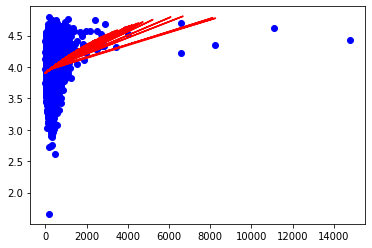

In [45]:
plt.scatter(X_test, y_test, color='blue')
plt.plot(X_train, regressor.predict(X_poly), color='red')
# why am I getting this strange result????